# **Endometriosis-revision-3**

In [ ]:
import sys
sys.path.append("../code")

In [ ]:
from code.data_prep.io import *
from code.data_prep.processing import *
from code.plotting.plot_settings import *
from code.plotting.palette import *

In [1]:
import scanpy as sc
from pathlib import Path
import numpy as np
import pandas as pd
import scrublet as scr

import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
%matplotlib inline
sc.settings.verbosity=3

In [3]:
main_dir = "/projects/robson-lab/research/endometriosis/"
sample_id = "Endometriosis-revision-3"

sc.settings.figdir = f"{main_dir}figures/{sample_id}"
matplotlib.rcParams["figure.facecolor"]="white"

In [5]:
sc.set_figure_params(dpi=150, color_map='Reds')
sns.set_style("white")

---

#### Doublet identification (Scrublet), QC & Filtering

done with scanpy-recipes with jupyterlab_1.3.1.sif

---

#### Combine Datasets

In [6]:
x = Path("/projects/robson-lab/research/endometriosis/analysis/")
qcs = []
for path in sorted(x.glob("*_output/*-qc_20211118.h5ad")):
    libraryid = (path.stem.split("-")[0])
    qcs.append(sc.read(path))

In [7]:
#check list shape
list(map(np.shape, qcs))

[(4818, 22211),
 (2563, 19918),
 (2848, 20967),
 (4051, 22561),
 (4349, 21191),
 (2426, 20544),
 (4003, 22614),
 (5506, 22222),
 (3004, 20548),
 (3114, 21440),
 (2544, 20545),
 (1959, 19081),
 (2414, 20594),
 (2977, 21256),
 (3612, 21749),
 (4063, 22026),
 (1961, 20610),
 (4928, 22109),
 (2724, 21771),
 (3715, 21031),
 (2245, 19945),
 (2061, 20570),
 (3685, 21926),
 (1661, 19970),
 (407, 16397),
 (4615, 21855),
 (782, 17044),
 (2924, 21420),
 (6401, 22148),
 (12161, 21207),
 (6527, 22439)]

In [8]:
len (qcs)

31

**don't forget to change** <br>  comb.uns["sampleid"] = "directory_name" <br>
    comb.uns["output_dir"] = "/path/to/data/filename/"

In [10]:
combined = merge_adata(*qcs)

In [11]:
combined.obs["sample_type"] = combined.obs.sample_name

In [12]:
combined

AnnData object with n_obs × n_vars = 111048 × 26636
    obs: 'sequencing_saturation', 'Patient_id', 'stage', 'scrublet_predicted_doublet', 'scrublet_score', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mitochondrial', 'log1p_total_counts_mitochondrial', 'pct_counts_mitochondrial', 'total_counts_hemoglobin', 'log1p_total_counts_hemoglobin', 'pct_counts_hemoglobin', 'library', '10x_chemistry', 'sample_name', 'sampleid', 'sample_type'
    var: 'gene_ids', 'mitochondrial', 'hemoglobin', 'total_counts', 'n_cells_by_counts'
    uns: 'sampleid', 'output_dir'

In [13]:
combined.obs.sample_name.value_counts()

Eutopic           30933
Ectopic Ovary     25548
Ectopic           25276
Ectopic Adj       15038
Eutopic Normal    14253
Name: sample_name, dtype: int64

In [14]:
save_adata(combined,"combined")

... storing 'Patient_id' as categorical
... storing 'stage' as categorical
... storing '10x_chemistry' as categorical
... storing 'sample_name' as categorical
... storing 'sampleid' as categorical
... storing 'sample_type' as categorical


---

#### Compute Highly variable genes
<br>**Note**: this command will run data normalization before computing highly_variable_genes, 
<br> then it will remove mito-, hemo-, ribo- & cell_cycle genes from highly_variable_genes

In [6]:
combined = sc.read_h5ad(f"{main_dir}data/h5ad/{sample_id}/{sample_id}-combined-20211210.h5ad")

In [7]:
bool_map = {"True": True, "False": False, "nan": False, True: True, False: False}
bool_func = lambda x: x.map(bool_map)

In [8]:
combined.var["mitochondrial"] = np.logical_or.reduce(
    combined.var.loc[:, combined.var.columns.str.startswith("mito")].apply(bool_func, axis=1).values, 
    axis=1
)
combined.var["hemoglobin"] = np.logical_or.reduce(
    combined.var.loc[:, combined.var.columns.str.startswith("hemo")].apply(bool_func, axis=1).values, 
    axis=1
)

combined.var["ribosomal"] = combined.var_names.str.startswith("RPL") |\
                            combined.var_names.str.startswith("RPS") |\
                            combined.var_names.str.startswith("MRPL") |\
                            combined.var_names.str.startswith("MRPS")

In [9]:
#cell_cycle & stress_response gene list (Kieran et al.)
sr_genes = pd.read_csv("../databases/coregene_stress-response.csv", header=0, index_col=6).index
cc_genes = pd.read_csv("../databases/cell_cycle.csv", header=0, index_col=1).index[:484]

In [10]:
combined.var["cell_cycle"]  = combined.var_names.isin(cc_genes)
combined.var["stress_response"] = combined.var_names.isin(sr_genes)

In [12]:
full = preprocess(combined, n_top_genes=2000)

normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:21)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [13]:
#check value after normalization
print (full.X.max())
print (full.layers["normed"].max())
print (full.layers["raw"].max())

8.913188
7428.3076
54610.0


---

#### Batch Corrections

In [14]:
%load_ext rpy2.ipython

In [15]:
sc.pp.pca(full, svd_solver="arpack",use_highly_variable=True)

    on highly variable genes
computing PCA with n_comps = 50
    finished (0:01:30)


In [16]:
pcs = full.obsm["X_pca"]
metadata = full.obs
covariates = ["Patient_id","sample_type","stage"]
thetas = np.array([1,1,0.5])

In [17]:
%%R -i pcs -i covariates -i thetas -i metadata -o pcs_harmony
library(harmony)
pcs_harmony <- HarmonyMatrix(
    pcs,
    metadata,
    vars_use=covariates,
    theta=thetas,
    do_pca=FALSE
)

R[write to console]: Loading required package: Rcpp

R[write to console]: Harmony 1/10

R[write to console]: 0%   10   20   30   40   50   60   70   80   90   100%

R[write to console]: [----|----|----|----|----|----|----|----|----|----|

R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[

In [19]:
harmonized = load_pcs(full, pcs_harmony)

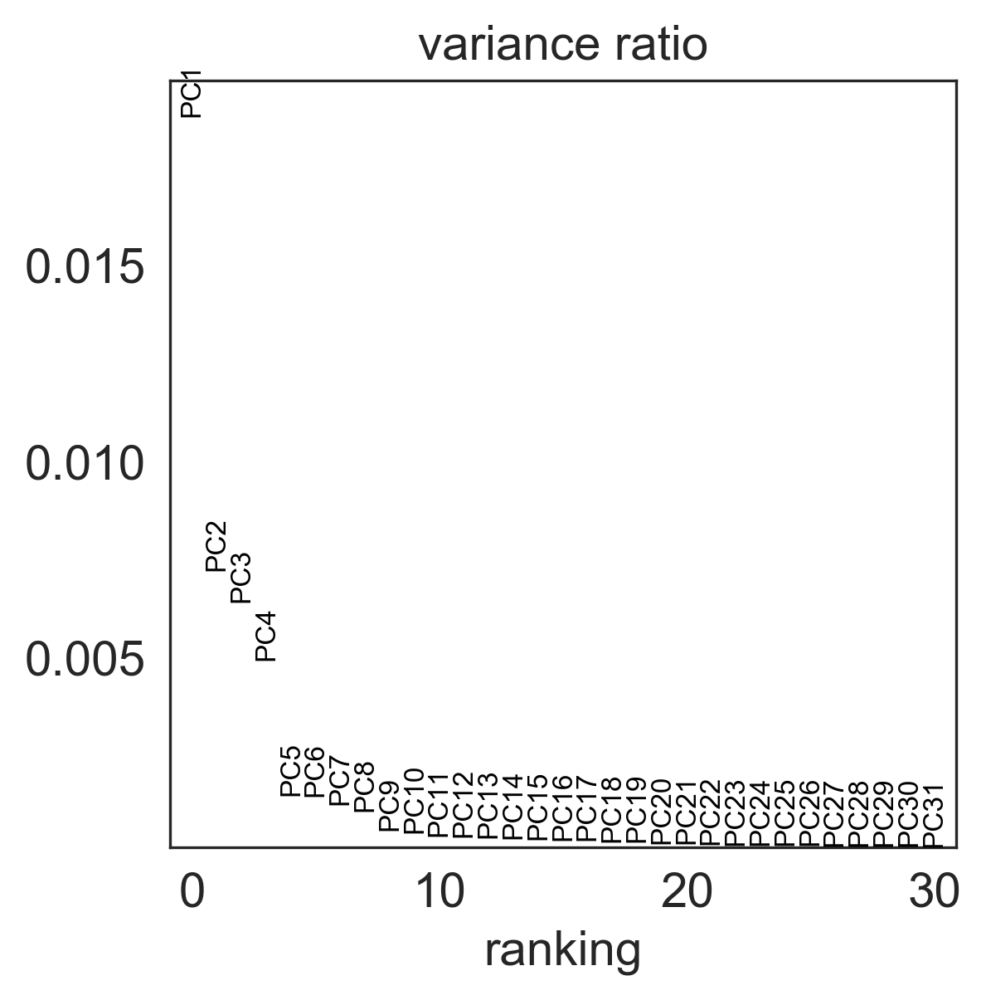

In [20]:
sc.pl.pca_variance_ratio(harmonized,show=False)

In [21]:
sc.pp.neighbors(harmonized, n_neighbors=15, n_pcs=10, metric="correlation")
sc.tl.umap(harmonized, min_dist=0.1)

computing neighbors
    using 'X_pca' with n_pcs = 10


/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:121: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['distances'] = neighbors.distances
/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:122: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'] = neighbors.connectivities


    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:33:33)
computing UMAP


/opt/conda/lib/python3.7/site-packages/scanpy/tools/_umap.py:147: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'].tocoo(),


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:09:00)


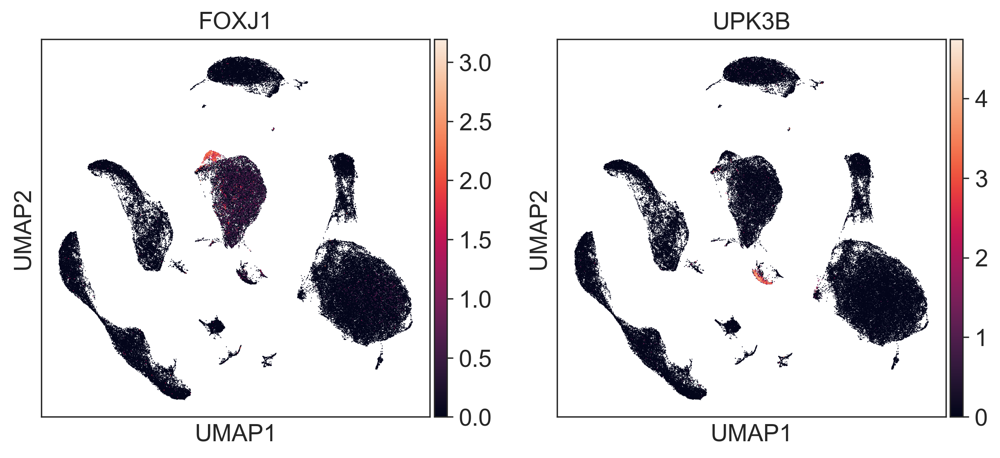

In [23]:
sc.pl.umap(harmonized, color=["FOXJ1","UPK3B"])

---

#### Clustering

running Leiden clustering


/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']


    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:03:42)


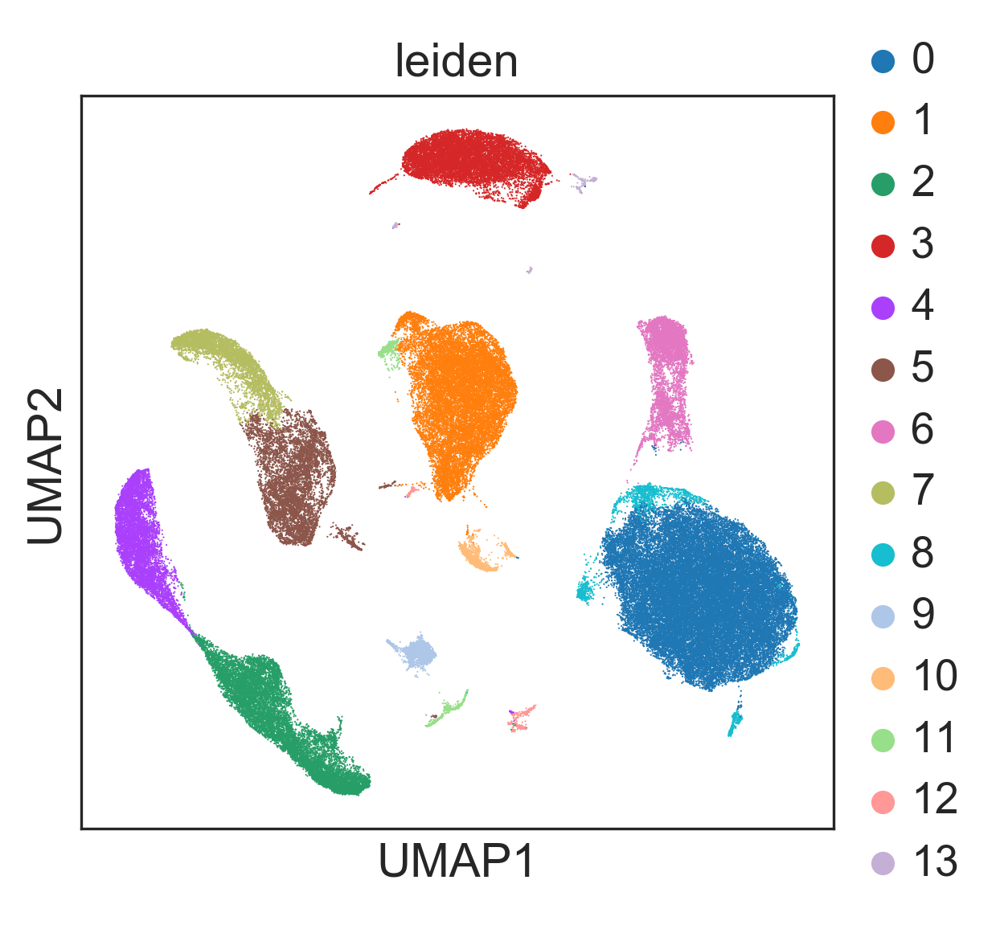

In [26]:
sc.tl.leiden(harmonized, resolution=0.3)
sc.pl.umap(harmonized, 
           color=["leiden"],
           use_raw=False,
          )

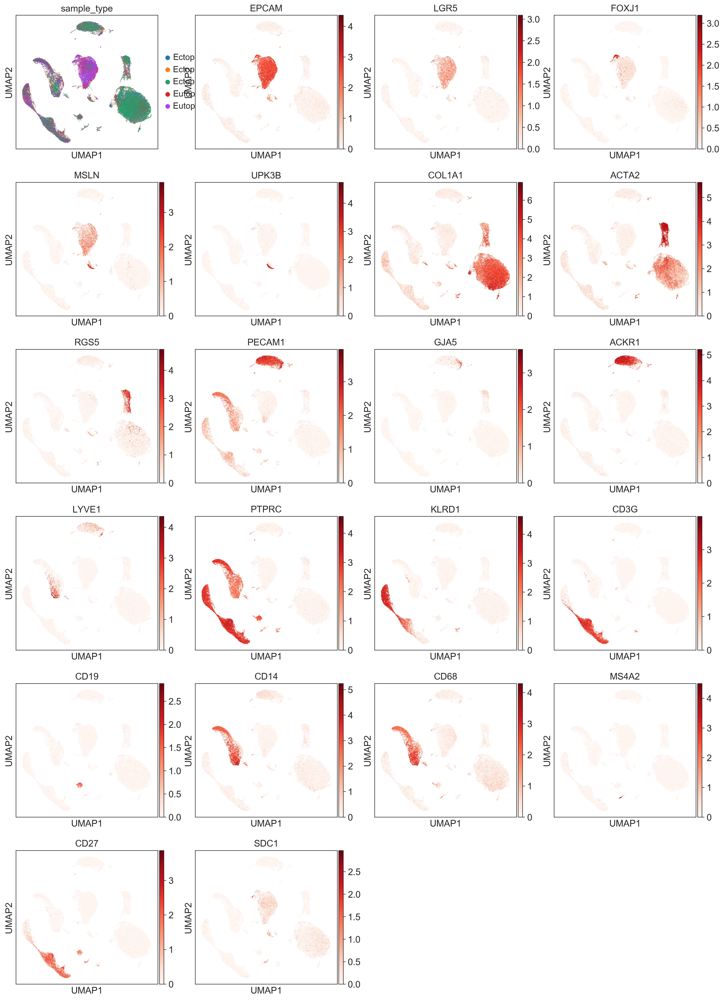

In [27]:
sc.pl.umap(harmonized,
          color = ["sample_type","EPCAM","LGR5","FOXJ1","MSLN","UPK3B","COL1A1","ACTA2","RGS5",
                   "PECAM1","GJA5","ACKR1","LYVE1","PTPRC","KLRD1","CD3G","CD19","CD14","CD68","MS4A2",
                   "CD27","SDC1"],
          use_raw = False,
          ncols = 4,
          wspace = 0.15,
          color_map = "Reds")

In [28]:
save_adata(harmonized, "harmonized")

---

#### Doublet Identification

***Scrublet***
<br>
scrublet prediction was ran separately on each dataset before QC, do `adata.obs_keys()` to check

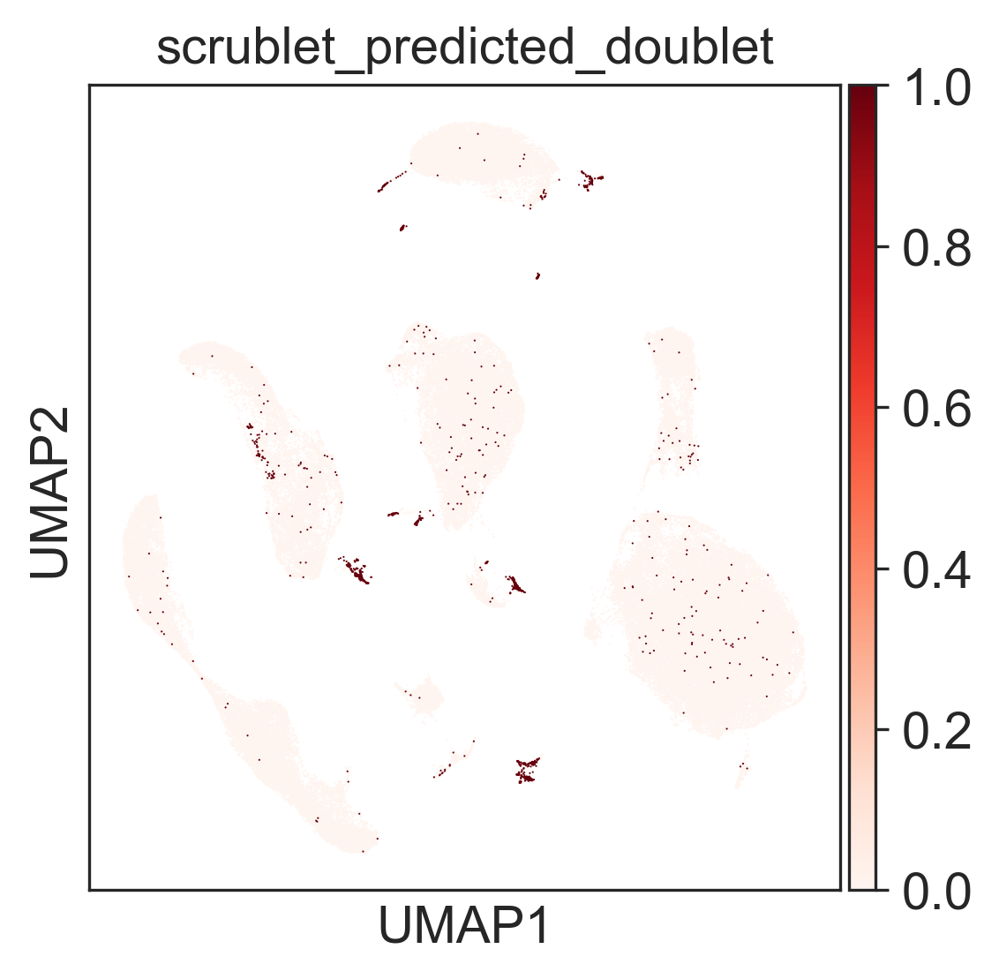

In [29]:
sc.pl.umap(harmonized, 
           color=["scrublet_predicted_doublet"],
           use_raw=False, 
           #save='-predicted-doublet_20200328.png', 
           color_map='Reds')

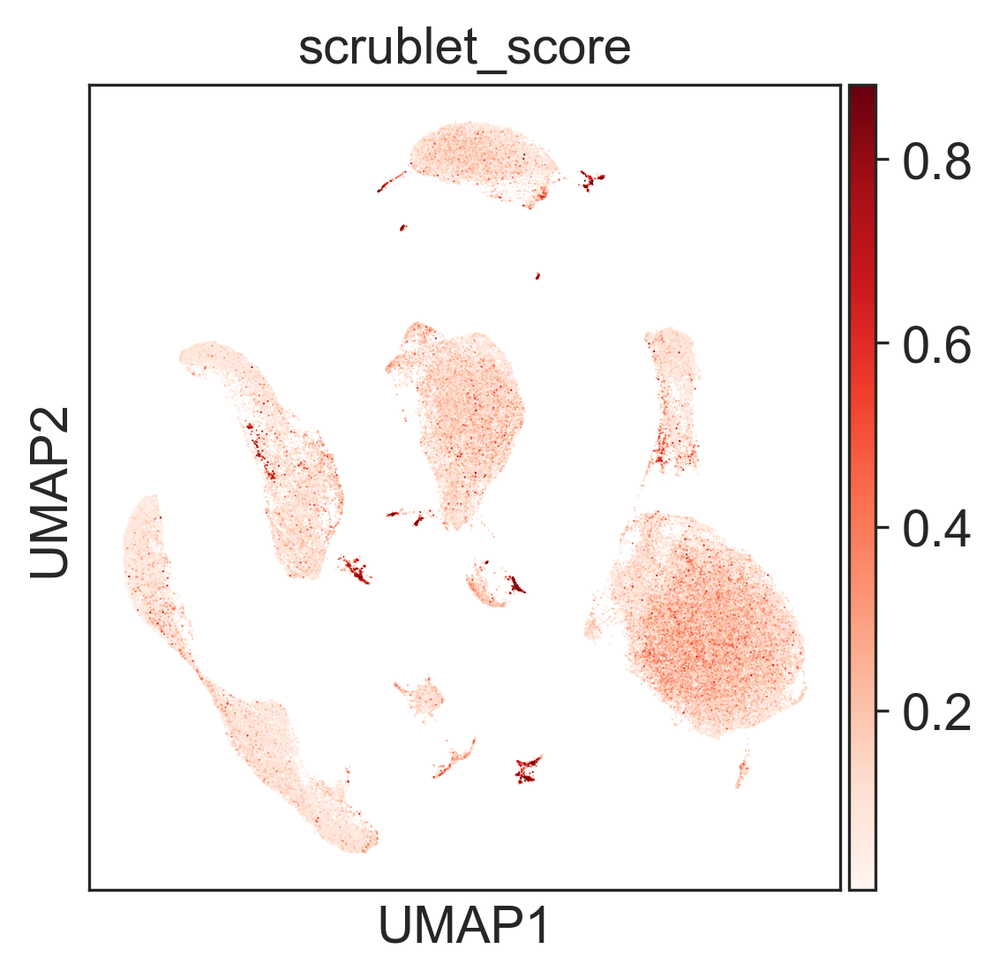

In [30]:
sc.pl.umap(harmonized, 
           color=["scrublet_score"],
           use_raw=False, 
           color_map='Reds')

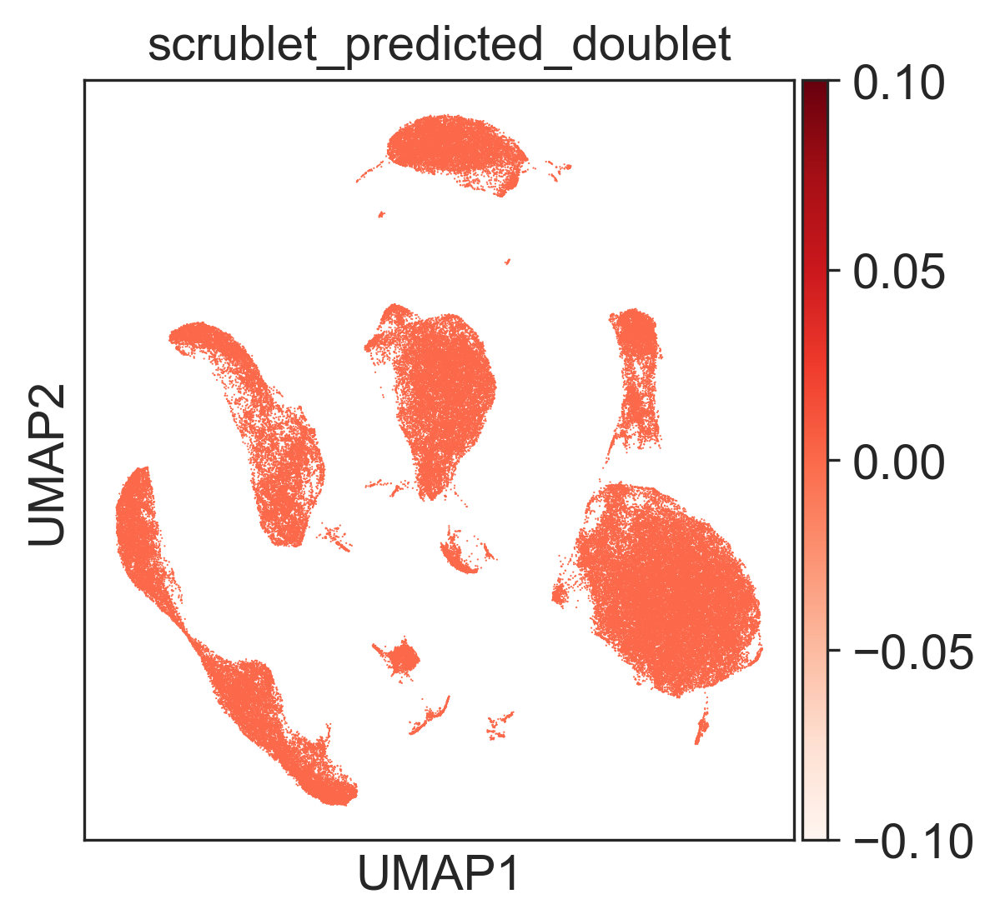

In [31]:
no_doublets = harmonized[~harmonized.obs.scrublet_predicted_doublet,:].copy()
sc.pl.umap(no_doublets, 
           color=["scrublet_predicted_doublet"],
           use_raw=False,color_map="Reds", 
           #save='-post-scrub_20200328.png'
           )

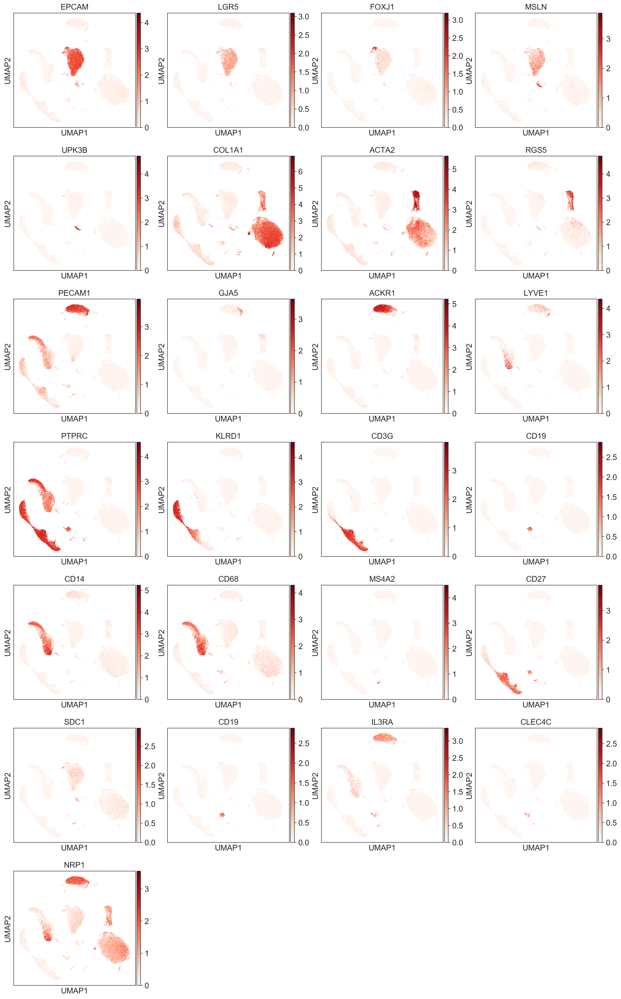

In [32]:
sc.pl.umap(no_doublets,
           color = ["EPCAM","LGR5","FOXJ1","MSLN","UPK3B","COL1A1","ACTA2","RGS5",
                    "PECAM1","GJA5","ACKR1","LYVE1","PTPRC","KLRD1","CD3G","CD19","CD14","CD68","MS4A2",
                    "CD27","SDC1","CD19","IL3RA","CLEC4C","NRP1"],
           use_raw = False, ncols = 4, wspace = 0.15, color_map = "Reds")

In [33]:
save_adata(no_doublets, "scrubs")

***visible doublet***

In [ ]:
no_doublets = sc.read(f"{main_dir}/data/h5ad/{sample_id}/{sample_id}-scrubs-20220103.h5ad")

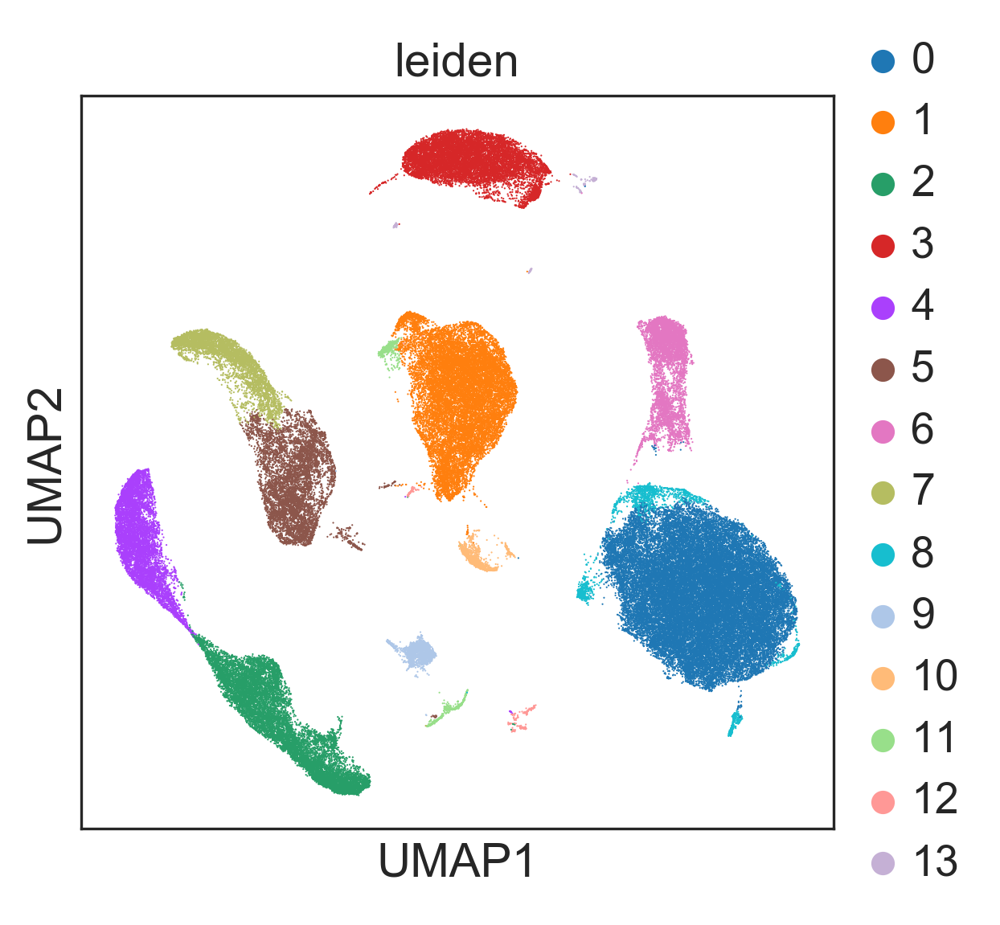

In [35]:
sc.pl.umap(no_doublets,color =["leiden"])

running Leiden clustering


/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']


    finished: found 27 clusters and added
    'leiden_R4', the cluster labels (adata.obs, categorical) (0:00:07)
running Leiden clustering


/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']


    finished: found 28 clusters and added
    'leiden_R5', the cluster labels (adata.obs, categorical) (0:00:07)
running Leiden clustering


/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']


    finished: found 32 clusters and added
    'leiden_R6', the cluster labels (adata.obs, categorical) (0:00:15)
running Leiden clustering


/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']


    finished: found 34 clusters and added
    'leiden_R7', the cluster labels (adata.obs, categorical) (0:00:09)


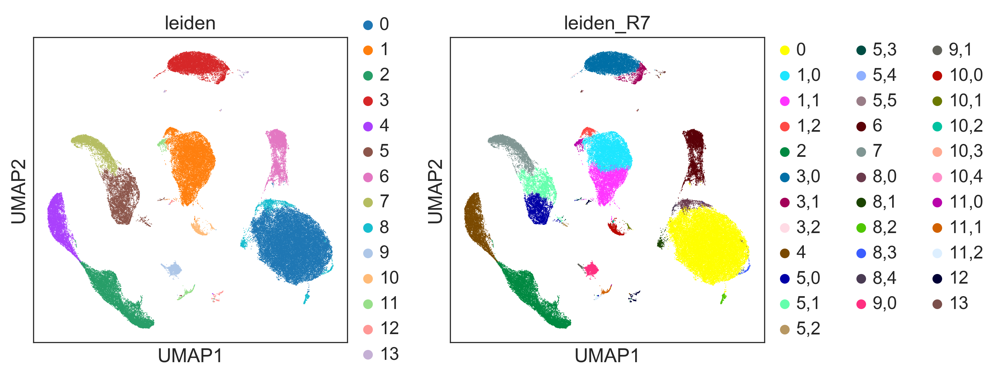

In [38]:
sc.tl.leiden(no_doublets, resolution=0.1, key_added="leiden_R1", restrict_to=("leiden", ['1']))
sc.tl.leiden(no_doublets, resolution=0.1, key_added="leiden_R2", restrict_to=("leiden_R1", ['3']))
sc.tl.leiden(no_doublets, resolution=0.1, key_added="leiden_R3", restrict_to=("leiden_R2", ['5']))
sc.tl.leiden(no_doublets, resolution=0.2, key_added="leiden_R4", restrict_to=("leiden_R3", ['8']))
sc.tl.leiden(no_doublets, resolution=0.1, key_added="leiden_R5", restrict_to=("leiden_R4", ['9']))
sc.tl.leiden(no_doublets, resolution=0.1, key_added="leiden_R6", restrict_to=("leiden_R5", ['10']))
sc.tl.leiden(no_doublets, resolution=0.1, key_added="leiden_R7", restrict_to=("leiden_R6", ['11']))
sc.pl.umap(no_doublets,color =["leiden","leiden_R7"])

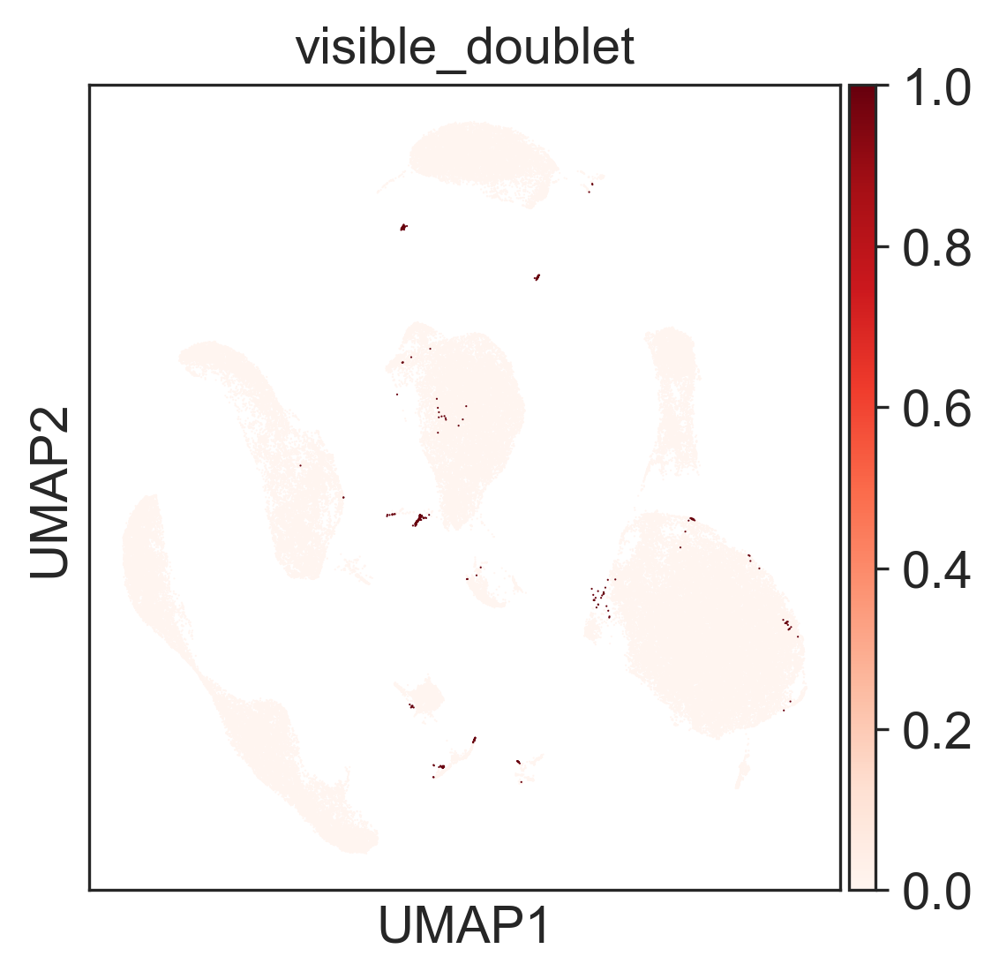

In [39]:
detect_umap_doublets(no_doublets, cluster_key= "leiden_R7", t=8)
sc.pl.umap(no_doublets,color=["visible_doublet"], color_map="Reds")

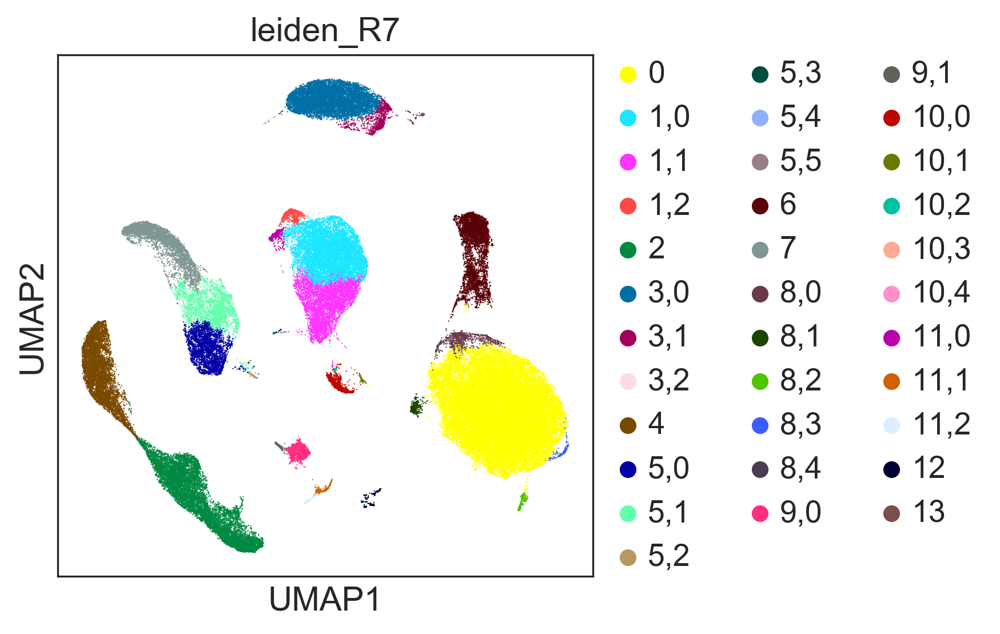

In [41]:
clean = no_doublets[~no_doublets.obs.visible_doublet,:].copy()
sc.pl.umap(clean,color =["leiden_R7"])

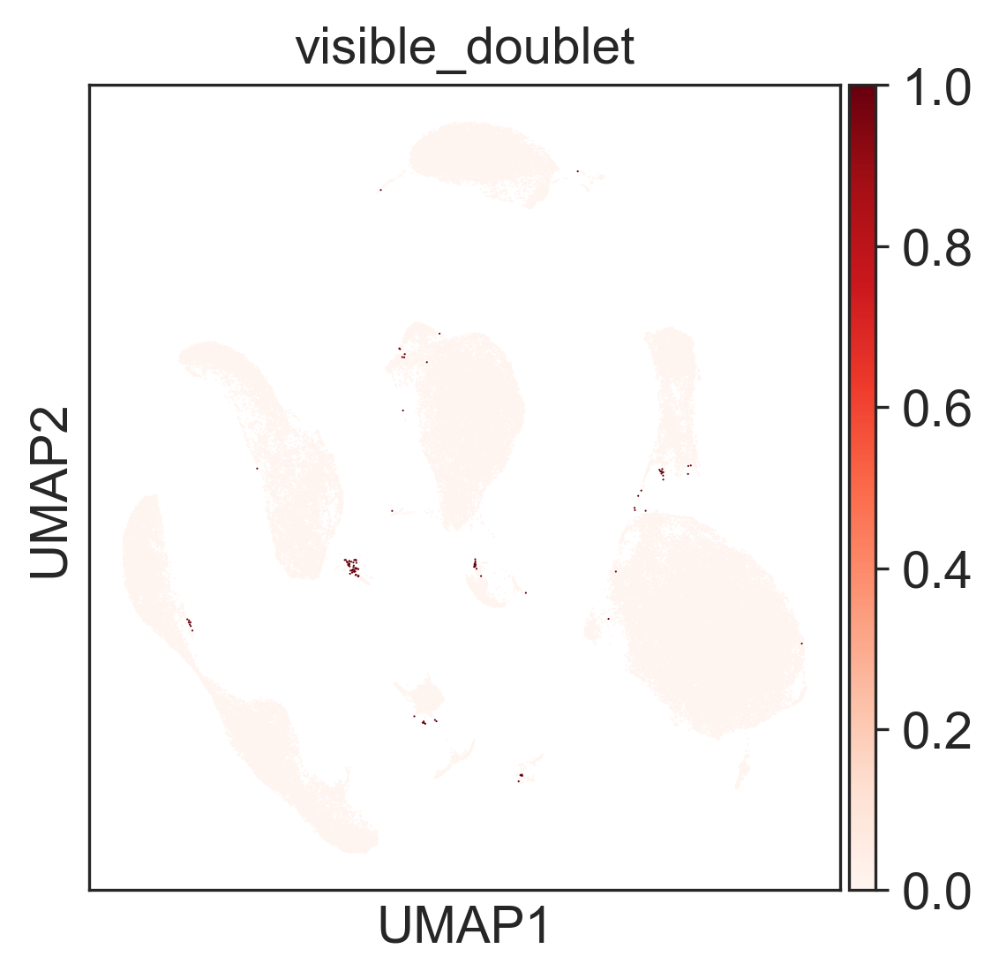

In [42]:
detect_umap_doublet(clean, cluster_key= "leiden_R7", t=6)
sc.pl.umap(clean,color=["visible_doublet"], color_map="Reds")

In [43]:
clean = clean[~clean.obs.visible_doublet,:]

In [44]:
clean.obs["leiden_R7"].value_counts()

0       35925
2       12553
1,0     10538
3,0      9725
4        7677
1,1      5929
6        5773
7        4859
5,0      3761
5,1      3205
9,0      1626
10,0     1371
3,1      1158
8,0       946
1,2       848
11,0      559
11,1      426
8,1       425
8,2       375
11,2      361
12        194
9,1       185
8,3       176
13        162
8,4        96
5,2        93
10,1       77
5,3        51
10,2       37
3,2        36
10,4        1
10,3        1
5,4         1
5,5         1
Name: leiden_R7, dtype: int64

In [45]:
#remove cluster which contain only 1 cell
outliers =["5,4","5,5","10,3","10,4"]
clean = clean[~clean.obs.leiden_R7.isin(outliers)].copy()

In [47]:
reorder_clusters_hierarchical(clean,cluster_key="leiden_R7")

AnnData object with n_obs × n_vars = 109147 × 26636
    obs: 'sequencing_saturation', 'Patient_id', 'stage', 'scrublet_predicted_doublet', 'scrublet_score', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mitochondrial', 'log1p_total_counts_mitochondrial', 'pct_counts_mitochondrial', 'total_counts_hemoglobin', 'log1p_total_counts_hemoglobin', 'pct_counts_hemoglobin', 'library', '10x_chemistry', 'sample_name', 'sampleid', 'sample_type', 'leiden', 'leiden_R1', 'leiden_R2', 'leiden_R3', 'leiden_R4', 'leiden_R5', 'leiden_R6', 'leiden_R7', 'visible_doublet', 'cluster'
    var: 'gene_ids', 'mitochondrial', 'hemoglobin', 'total_counts', 'n_cells_by_counts', 'ribosomal', 'cell_cycle', 'stress_response', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'output_dir', 'sampleid', 'raw_dtype', 'n_top_gen

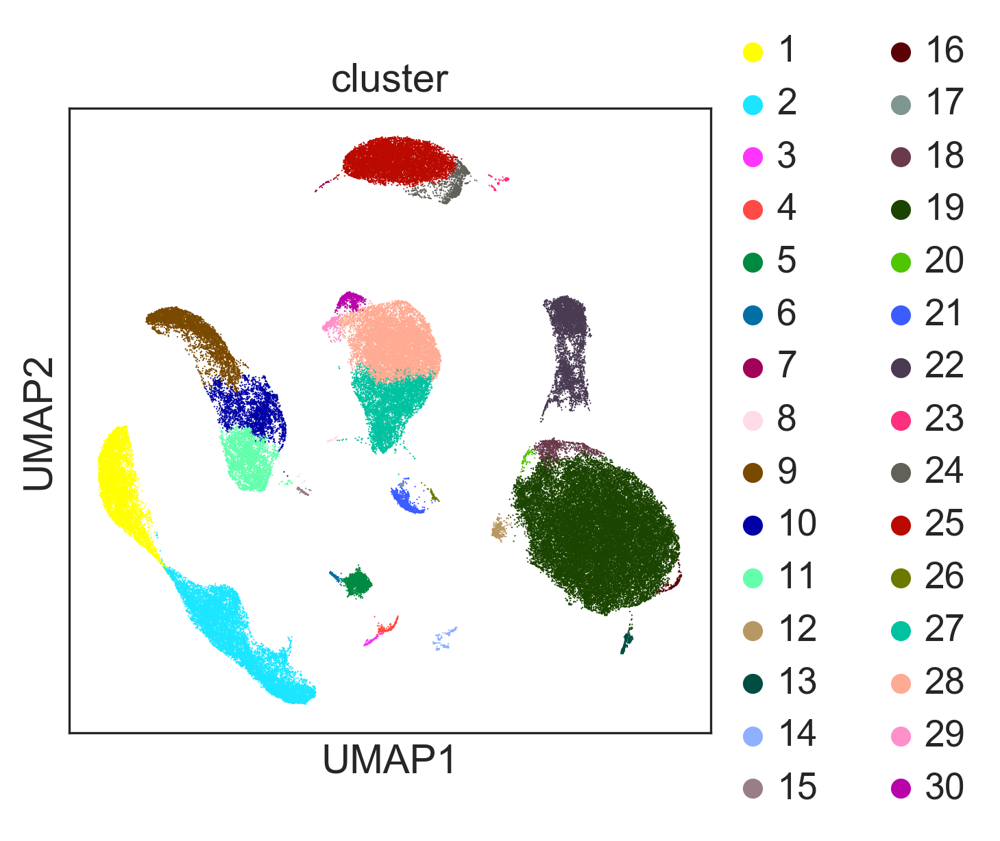

In [48]:
sc.pl.umap(clean, color = ["cluster"])

In [49]:
clean.obs.cluster.value_counts()

19    35925
2     12553
28    10538
25     9725
1      7677
27     5929
22     5773
9      4859
11     3761
10     3205
5      1626
21     1371
24     1158
18      946
30      848
29      559
4       426
12      425
13      375
3       361
14      194
6       185
16      176
23      162
20       96
15       93
26       77
8        51
17       37
7        36
Name: cluster, dtype: int64

In [50]:
save_adata(clean,"scrubs-clean")

***Cell_type Markers***

Note:
`sc.tl.rank_genes_groups(adata, groupby="cluster",use_raw=False,)` and `sc.tl.filter_rank_genes_groups(clean, use_raw=False)` will cause warning for adata saving, and subsequently error in adata loading. Copy the adata and run this function for doublet identification purpose. Once `doublet` identified, filter and save the original `adata`.

In [51]:
clean_copy = clean.copy()

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:42)
Filtering genes using: min_in_group_fraction: 0.5 min_fold_change: 2, max_out_group_fraction: 0.05


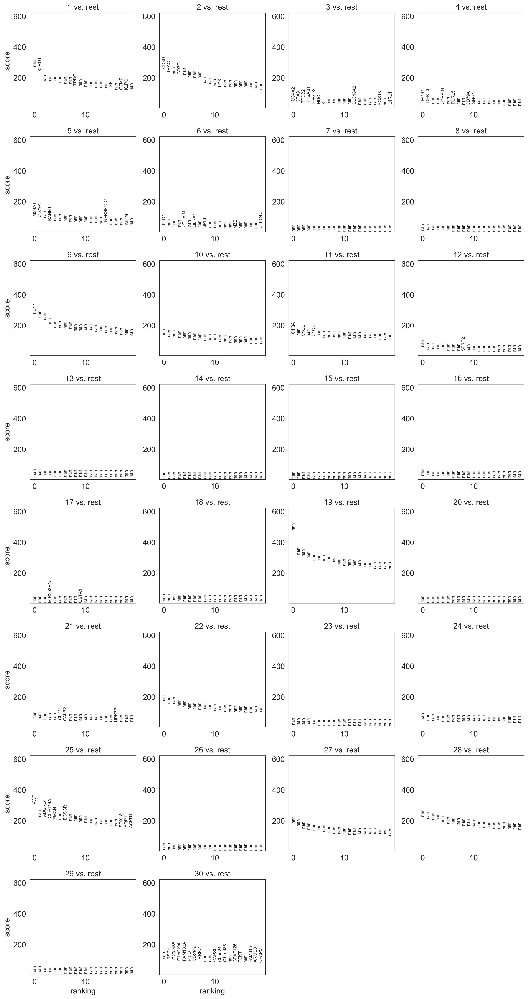

In [52]:
sc.tl.rank_genes_groups(clean_copy, groupby="cluster",use_raw=False)
sc.tl.filter_rank_genes_groups(clean_copy, use_raw=False, max_out_group_fraction= 0.05, min_in_group_fraction= 0.5)
sc.pl.rank_genes_groups(clean_copy,key='rank_genes_groups_filtered')

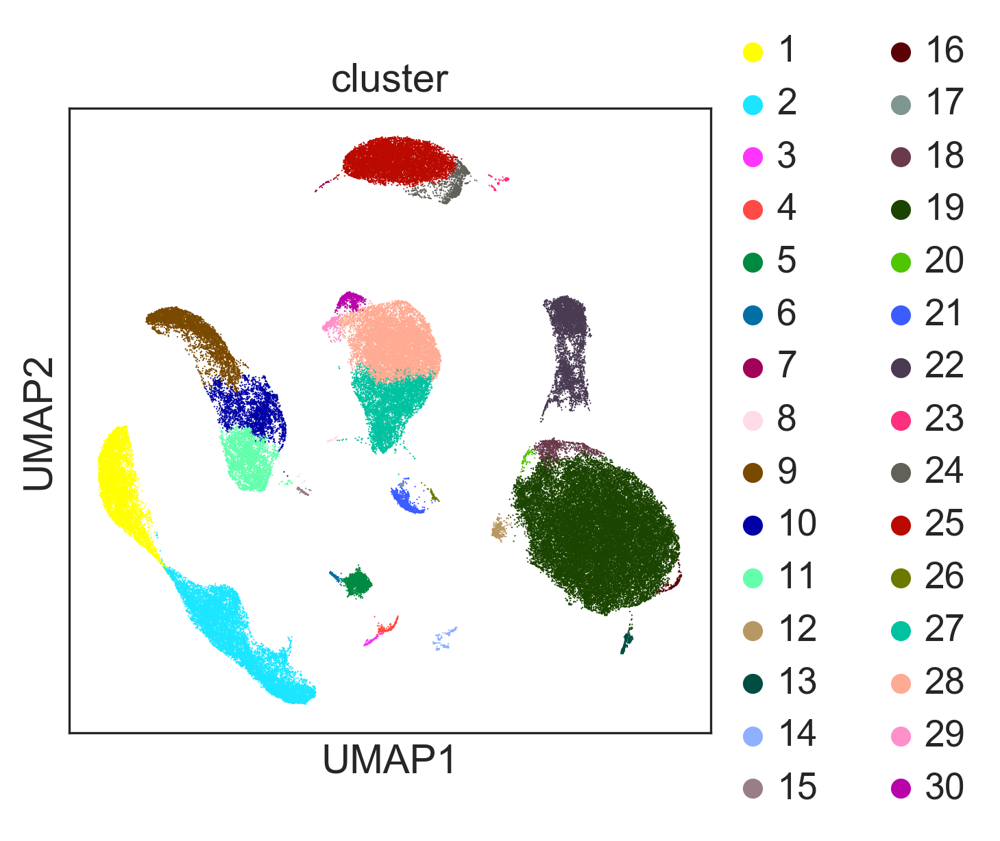

In [55]:
sc.pl.umap(clean, color=["cluster"],
           #groups=["27","21","19","22","25","9","5","2","1"],
           color_map="Reds")

In [56]:
pure_clusters = ["27","21","19","22","25","9","5","2","1"]
doublet_clusters = ["3","4","6","7","8","10","11","12","13","14","15","16","17","18",
                    "20","23","24","26","28","29","30"]
doublet_clusters_plus = pure_clusters + doublet_clusters
var_group_labels = ["Epithelial", "Mesothelial", "Fibroblast", "Pericytes/vsm","Endothelial", "Myeloid","B-lympho","T-lympho","NK"]
var_group_positions = list(zip(range(0, 27, 3), range(2, 27, 3)))
doublet_genes = [
    "EPCAM", "CLDN3", "ASRGL1",
    "MSLN", "UPK3B", "CLDN15",
    "COL1A1", "RAMP1", "LUM",
    "RGS5", "NOTCH3", "MYH11",
    "VWF","CLEC14A", "ADGRL4",
    "PTPRC","CD14","CD68",
    "MS4A1","CD79A","BANK1",
    "CD3D", "CD3G","CD8A",
    "KLRD1","NCAM1","TRDC"
]

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:24: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


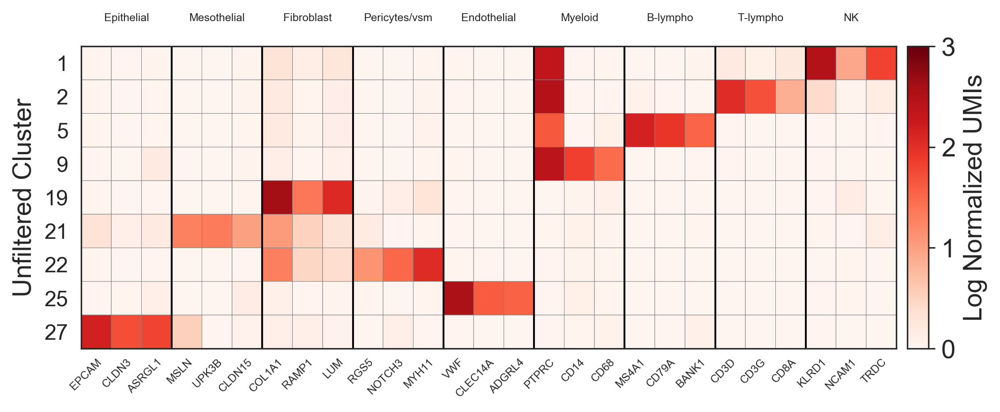

In [57]:
subset = clean[clean.obs.cluster.isin(pure_clusters)].copy()
cg = sc.pl.matrixplot(
    subset, 
    doublet_genes, use_raw=False, groupby="cluster", 
    var_group_labels=var_group_labels, var_group_positions=var_group_positions,
    var_group_rotation=0, 
    cmap="Reds", vmin=0, vmax=3,
    show=False, figsize=(8, 3)
)
fig = plt.gcf()
axs = fig.get_axes()
axs[0].set_xticklabels(axs[0].get_xticklabels(), rotation=45, ha="right", size=6, va="top", rotation_mode="anchor");
axs[0].tick_params(axis="x", pad=1)
axs[0].set_ylabel("Unfiltered Cluster")
for y in range(3, 27, 3):
    axs[0].axvline(y, lw=1, color="k")
axs[2].set_ylabel("Log Normalized UMIs")
for child in axs[1].get_children():
    if isinstance(child, matplotlib.text.Text):
        child.set_fontsize(6)
    elif isinstance(child, matplotlib.patches.PathPatch):
        child.set_linewidth(0.75)
fig.subplots_adjust(right=0.9, left=0.1, bottom=0.2, top=0.9)
fig.tight_layout(rect=(0.05, 0.05, 0.95, 0.95))

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:24: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


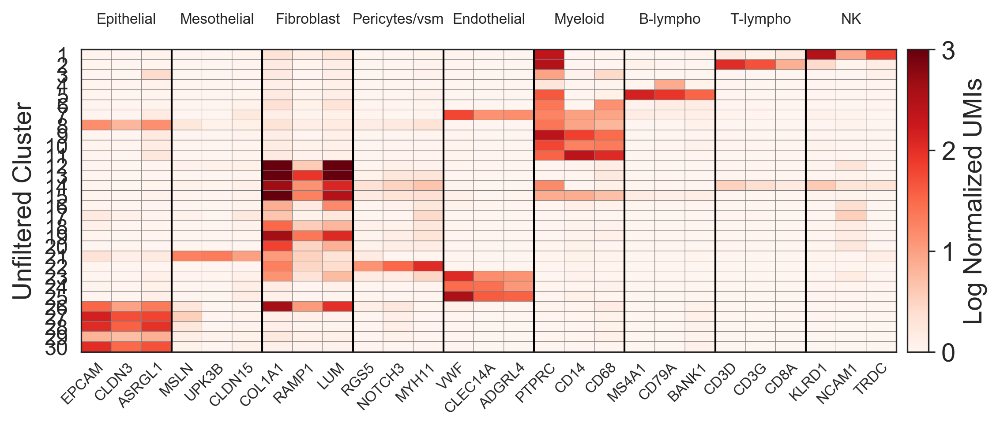

In [58]:
subset = clean[clean.obs.cluster.isin(doublet_clusters_plus)].copy()
cg = sc.pl.matrixplot(
    subset, 
    doublet_genes, use_raw=False, groupby="cluster", 
    var_group_labels=var_group_labels, var_group_positions=var_group_positions,
    var_group_rotation=0, 
    cmap="Reds", vmin=0, vmax=3,
    show=False, figsize=(8, 3)
)
fig = plt.gcf()
axs = fig.get_axes()
axs[0].set_xticklabels(axs[0].get_xticklabels(), rotation=45, ha="right", size=8, va="top", rotation_mode="anchor");
axs[0].tick_params(axis="x", pad=1)
axs[0].set_ylabel("Unfiltered Cluster")
for y in range(3, 27, 3):
    axs[0].axvline(y, lw=1, color="k")
axs[2].set_ylabel("Log Normalized UMIs")
for child in axs[1].get_children():
    if isinstance(child, matplotlib.text.Text):
        child.set_fontsize(8)
    elif isinstance(child, matplotlib.patches.PathPatch):
        child.set_linewidth(0.75)
fig.subplots_adjust(right=0.9, left=0.1, bottom=0.2, top=0.9)
fig.tight_layout(rect=(0.05, 0.05, 0.95, 0.95))

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:24: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


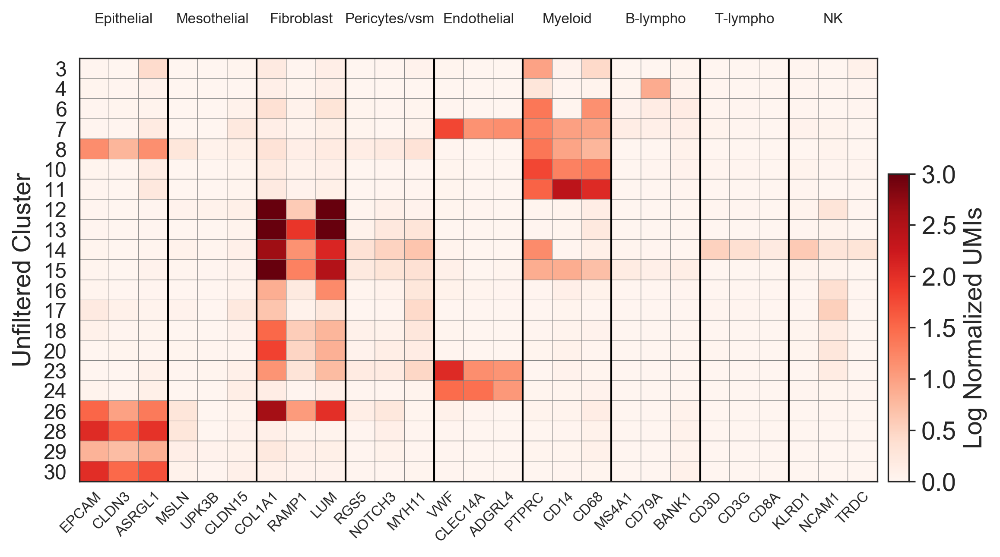

In [59]:
subset = clean[clean.obs.cluster.isin(doublet_clusters)].copy()
cg = sc.pl.matrixplot(
    subset, 
    doublet_genes, use_raw=False, groupby="cluster", 
    var_group_labels=var_group_labels, var_group_positions=var_group_positions,
    var_group_rotation=0, 
    cmap="Reds", vmin=0, vmax=3,
    show=False, figsize=(8, 4.5)
)
fig = plt.gcf()
axs = fig.get_axes()
axs[0].set_xticklabels(axs[0].get_xticklabels(), rotation=45, ha="right", size=8, va="top", rotation_mode="anchor");
axs[0].tick_params(axis="x", pad=1)
axs[0].set_ylabel("Unfiltered Cluster")
for y in range(3, 27, 3):
    axs[0].axvline(y, lw=1, color="k")
axs[2].set_ylabel("Log Normalized UMIs")
for child in axs[1].get_children():
    if isinstance(child, matplotlib.text.Text):
        child.set_fontsize(8)
    elif isinstance(child, matplotlib.patches.PathPatch):
        child.set_linewidth(0.75)
fig.subplots_adjust(right=0.9, left=0.1, bottom=0.2, top=0.9)
fig.tight_layout(rect=(0.05, 0.05, 0.95, 0.95))

In [64]:
doublets = ["7","8","14","15","17","23","26"]

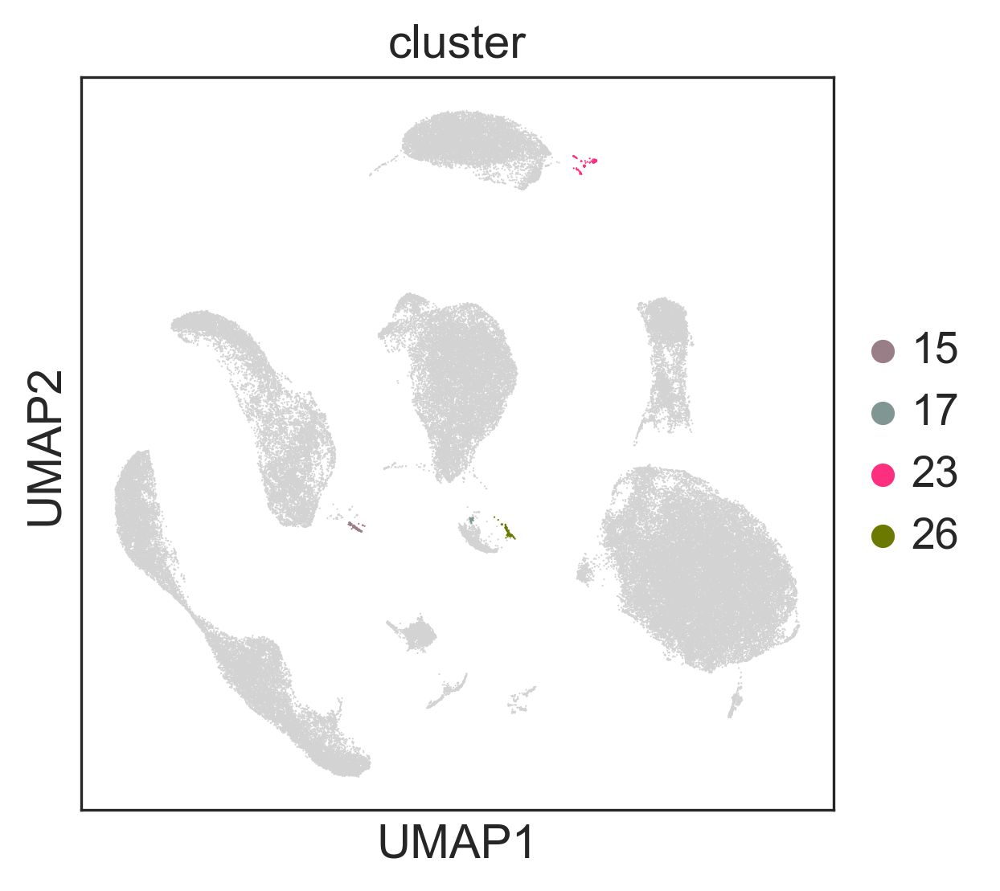

In [63]:
sc.pl.umap(clean, color=["cluster"],groups=["15","17","23","26"])

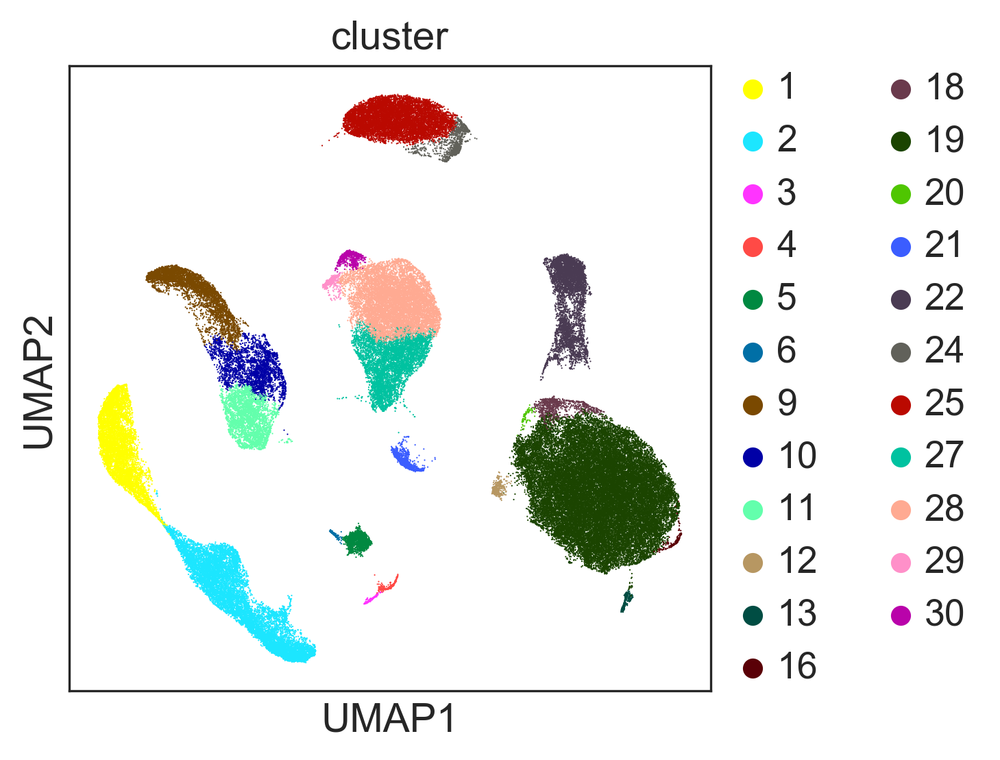

In [65]:
final_cluster = clean[~clean.obs.cluster.isin(doublets)].copy()
sc.pl.umap(final_cluster, color=["cluster"],color_map='Reds')

In [69]:
reorder_clusters_hierarchical(final_cluster,cluster_key="cluster", new_key="cluster_R1")

AnnData object with n_obs × n_vars = 108497 × 26636
    obs: 'sequencing_saturation', 'Patient_id', 'stage', 'scrublet_predicted_doublet', 'scrublet_score', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mitochondrial', 'log1p_total_counts_mitochondrial', 'pct_counts_mitochondrial', 'total_counts_hemoglobin', 'log1p_total_counts_hemoglobin', 'pct_counts_hemoglobin', 'library', '10x_chemistry', 'sample_name', 'sampleid', 'sample_type', 'leiden', 'leiden_R1', 'leiden_R2', 'leiden_R3', 'leiden_R4', 'leiden_R5', 'leiden_R6', 'leiden_R7', 'visible_doublet', 'cluster', 'cluster_R1'
    var: 'gene_ids', 'mitochondrial', 'hemoglobin', 'total_counts', 'n_cells_by_counts', 'ribosomal', 'cell_cycle', 'stress_response', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'output_dir', 'sampleid', 'raw_dtyp

cell# in clean = 109147 
<br>cell# in final_cluster = 108497
<br>Total doublets removed based on general cluster marker = 650 cells 

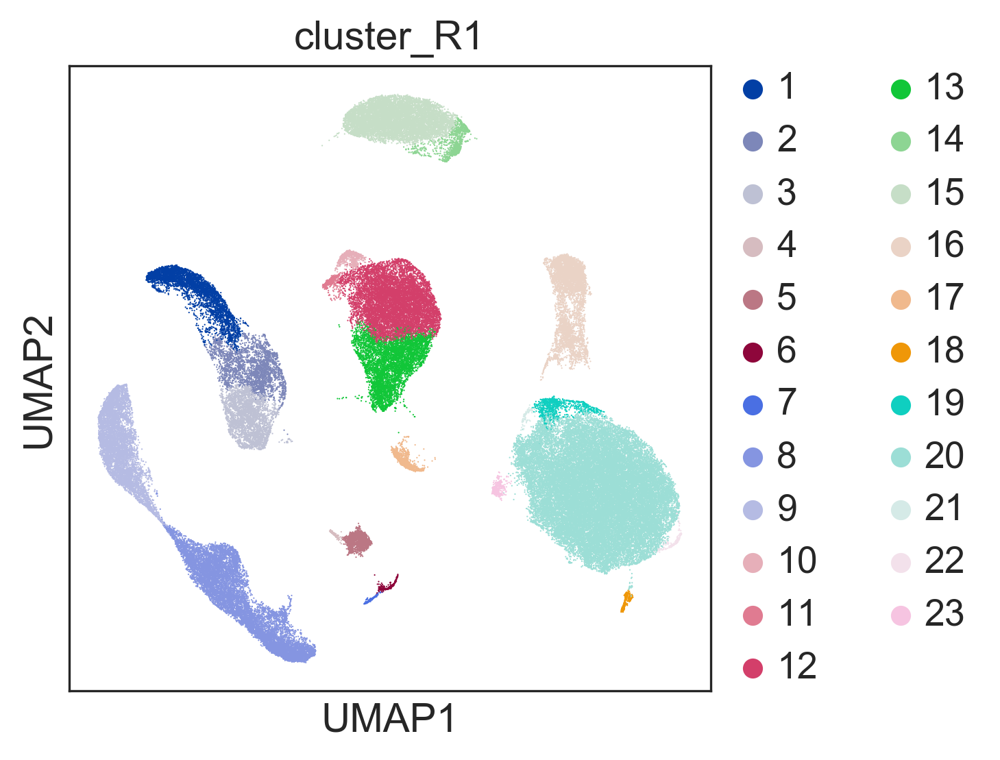

In [70]:
sc.pl.umap(final_cluster,color =["cluster_R1"])

In [71]:
final_cluster.obs.cluster_R1.value_counts()

20    35925
8     12553
12    10538
15     9725
9      7677
13     5929
16     5773
1      4859
3      3761
2      3205
5      1626
17     1371
14     1158
19      946
10      848
11      559
6       426
23      425
18      375
7       361
4       185
22      176
21       96
Name: cluster_R1, dtype: int64

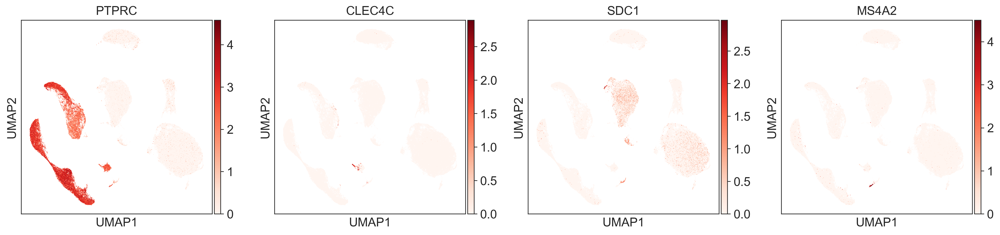

In [72]:
sc.pl.umap(final_cluster, color = ["PTPRC","CLEC4C","SDC1","MS4A2"],color_map="Reds")

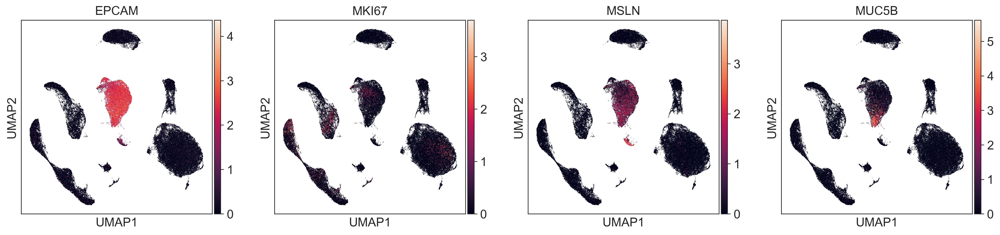

In [82]:
sc.pl.umap(final_cluster, color=["EPCAM","MKI67","MSLN","MUC5B"])

In [75]:
 final_cluster.obs["celltype"]= final_cluster.obs.cluster_R1.map({
    "1":"myeloid 1", 
    "2":"myeloid 2", 
    "3":"myeloid 3",
    "4":"pDC", 
    "5":"B-lymphocytes",
    "6":"plasma B-lymphocyte", 
    "7":"mast cells", 
    "8":"T-lymphocytes", 
    "9":"NK cells",
    "10":"cilliated epithelial",
    "11":"epithelial 1", 
    "12":"epithelial 2",
    "13":"epithelial 2", 
    "14":"endothelial",
    "15":"endothelial",
    "16":"mural cells",
    "17":"mesothelial",
    "18":"fibroblast 2",
    "19":"fibroblast 1",
    "20":"fibroblast 1",
     "21":"fibroblast 1",
     "22":"fibroblast 1",
     "23":"fibroblast 3",
    })
    
final_cluster.obs["celltype_main"]= final_cluster.obs.cluster_R1.map({
    "1":"myeloid", 
    "2":"myeloid", 
    "3":"myeloid",
    "4":"myeloid", 
    "5":"lymphocytes",
    "6":"lymphocytes",
    "7":"myeloid", 
    "8":"lymphocytes", 
    "9":"lymphocytes",
    "10":"epithelial", 
    "11":"epithelial", 
    "12":"epithelial",
    "13":"epithelial",
    "14":"endothelial",
    "15":"endothelial",
    "16":"stromal",
    "17":"epithelial",
    "18":"stromal",
    "19":"stromal",
    "20":"stromal",
    "21":"stromal",
    "22":"stromal",
    "23":"stromal",
    })

... storing 'celltype' as categorical
... storing 'celltype_main' as categorical


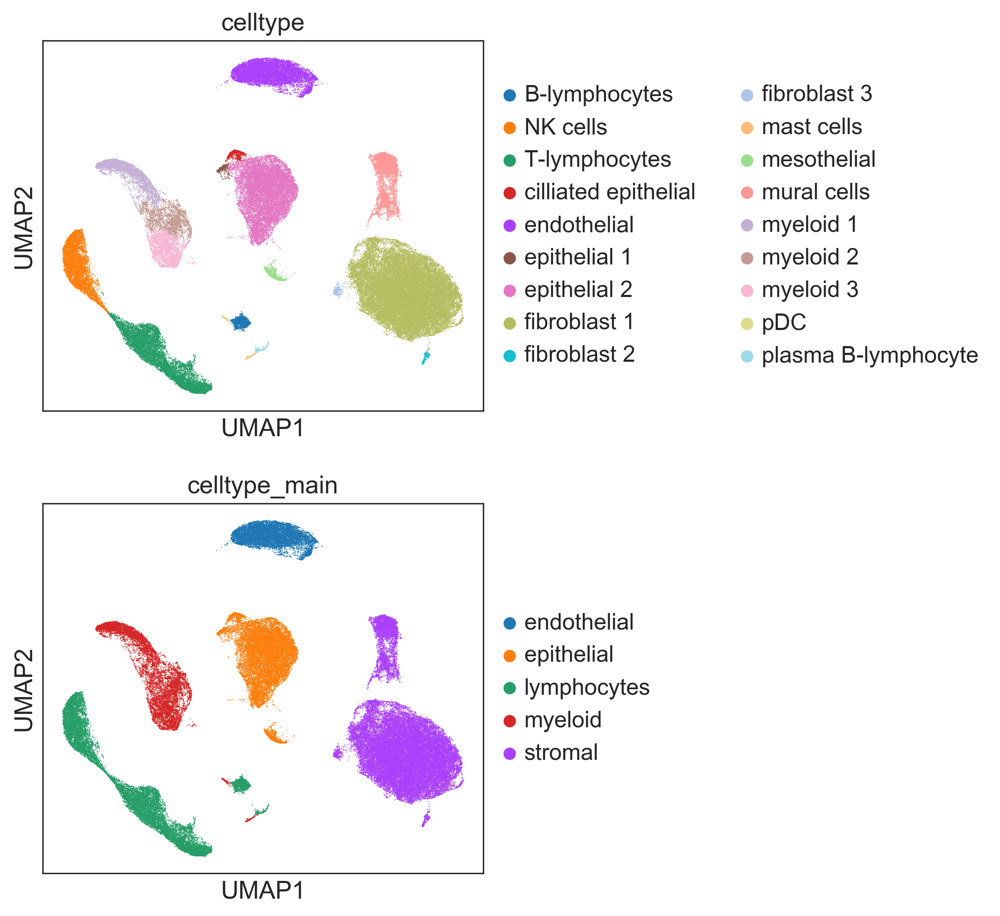

In [76]:
sc.pl.umap(final_cluster,color =["celltype","celltype_main"],ncols=1)

In [77]:
save_adata(final_cluster,"scrubs-clean-final")

---
## cell markers

In [78]:
markers = ["PTPRC","NKG7","KLRD1","CTSW",
           "CCL5","GZMA","CD3D",
           "IL7R","TRAC",
           "KLRB1","TRBC1","TMIGD2",
           "MS4A1","CD79A","BANK1",
           "PLD4","IRF8","BCL11A",
           "AIF1","CD68","SPI1","CSF1R",
           "FCN1","LYZ","S100A9",
           
           "VWF","EMCN","EGFL7",
           "MYH11","PLN","RERGL",
           "STEAP4","ABCC9","GGT5",
           "PDGFRA","MMP2","RAMP1",
           
           "MS4A2","CPA3","TPSB2",
           "MZB1","DERL3","JCHAIN",
           
           "MSLN","CALB2","UPK3B",
           "EPCAM","ASRGL1","CLDN3",
           "RSPH1","PIFO","FOXJ1",
           ]

In [79]:
new_order = ["PTPRC","S100A9","LYZ","FCN1","CSF1R","SPI1",
             "MS4A1","CD79A","BANK1",
             "AIF1","CD68","IRF8","BCL11A","PLD4",
             "MZB1","DERL3","JCHAIN",
             "MS4A2","CPA3","TPSB2",
             "CTSW","KLRD1","GZMA","CCL5","NKG7",
             "IL7R","TRAC","KLRB1","TRBC1","TMIGD2","CD3D",
             "PDGFRA","MMP2","RAMP1",
             "MYH11","PLN","RERGL",
             "STEAP4","ABCC9","GGT5",
             "RSPH1","PIFO","FOXJ1",
             "EPCAM","ASRGL1","CLDN3",
             "VWF","EMCN","EGFL7",
             "MSLN","CALB2","UPK3B",
            ]

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_celltype']`


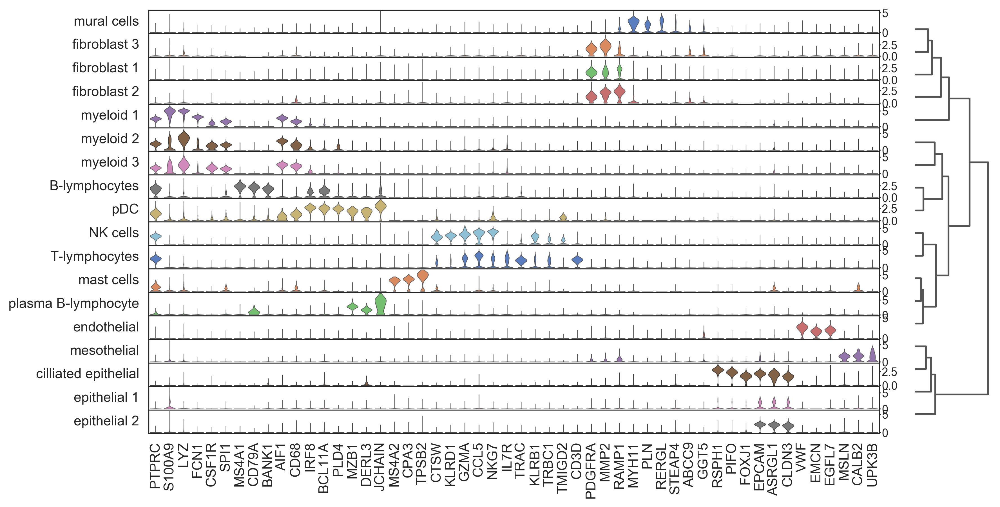

In [80]:
sc.pl.stacked_violin(final_cluster, var_names=new_order, groupby="celltype",
                    dendrogram=True, 
                     #save=".png"
                    )